<a href="https://colab.research.google.com/github/LC1332/Lulu-Diffusion-Experiment/blob/main/notebook/ip_adapter_plus_face_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -q insightface onnxruntime diffusers
!pip install -q git+https://github.com/tencent-ailab/IP-Adapter.git
!pip install -q einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.5/439.5 kB 5.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 30.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 55.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 58.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 10.3 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 1.7 MB/s eta 0:00:00


In [ ]:
!wget -O ip-adapter-faceid_sd15.bin https://huggingface.co/h94/IP-Adapter-FaceID/resolve/main/ip-adapter-faceid_sd15.bin?download=true

--2024-01-01 04:11:10--  https://huggingface.co/h94/IP-Adapter-FaceID/resolve/main/ip-adapter-faceid_sd15.bin?download=true
Resolving huggingface.co (huggingface.co)... 18.239.50.103, 18.239.50.49, 18.239.50.80, ...
Connecting to huggingface.co (huggingface.co)|18.239.50.103|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs-us-1.huggingface.co/repos/36/ca/36ca54ff1895000df817b45a5ae71fccd14170b0843d8adc2ba7944d9ac903e9/201344e22e6f55849cf07ca7a6e53d8c3b001327c66cb9710d69fd5da48a8da7?response-content-disposition=attachment%3B+filename*%3DUTF-8%27%27ip-adapter-faceid_sd15.bin%3B+filename%3D%22ip-adapter-faceid_sd15.bin%22%3B&response-content-type=application%2Foctet-stream&Expires=1704341470&Policy=eyJTdGF0ZW1lbnQiOlt7IkNvbmRpdGlvbiI6eyJEYXRlTGVzc1RoYW4iOnsiQVdTOkVwb2NoVGltZSI6MTcwNDM0MTQ3MH19LCJSZXNvdXJjZSI6Imh0dHBzOi8vY2RuLWxmcy11cy0xLmh1Z2dpbmdmYWNlLmNvL3JlcG9zLzM2L2NhLzM2Y2E1NGZmMTg5NTAwMGRmODE3YjQ1YTVhZTcxZmNjZDE0MTcwYjA4NDNkOGFkYzJiYTc5N

In [ ]:
import torch
from diffusers import StableDiffusionPipeline, StableDiffusionImg2ImgPipeline, StableDiffusionInpaintPipelineLegacy, DDIMScheduler, AutoencoderKL
from PIL import Image

from ip_adapter import IPAdapterPlus

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:
!mkdir /content/models
!mkdir /content/models/image_encoder

In [ ]:
!wget -O models/image_encoder/config.json https://huggingface.co/h94/IP-Adapter/resolve/main/models/image_encoder/config.json?download=true
!wget -O models/image_encoder/model.safetensors https://huggingface.co/h94/IP-Adapter/resolve/main/models/image_encoder/model.safetensors?download=true
!wget -O models/image_encoder/pytorch_model.bin https://huggingface.co/h94/IP-Adapter/resolve/main/models/image_encoder/pytorch_model.bin?download=true

--2024-01-01 04:11:23--  https://huggingface.co/h94/IP-Adapter/resolve/main/models/image_encoder/config.json?download=true
Resolving huggingface.co (huggingface.co)... 18.239.50.103, 18.239.50.49, 18.239.50.80, ...
Connecting to huggingface.co (huggingface.co)|18.239.50.103|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 560 [text/plain]
Saving to: ‘models/image_encoder/config.json’

models/image_encode 100%[===================>]     560  --.-KB/s    in 0s      

2024-01-01 04:11:23 (311 MB/s) - ‘models/image_encoder/config.json’ saved [560/560]

--2024-01-01 04:11:23--  https://huggingface.co/h94/IP-Adapter/resolve/main/models/image_encoder/model.safetensors?download=true
Resolving huggingface.co (huggingface.co)... 18.239.50.103, 18.239.50.49, 18.239.50.80, ...
Connecting to huggingface.co (huggingface.co)|18.239.50.103|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs.huggingface.co/repos/6f/e5/6fe5d8840a1ab462e1

In [ ]:
!wget -O models/ip-adapter-plus-face_sd15.bin https://huggingface.co/h94/IP-Adapter/resolve/main/models/ip-adapter-plus-face_sd15.bin?download=true

--2024-01-01 04:11:56--  https://huggingface.co/h94/IP-Adapter/resolve/main/models/ip-adapter-plus-face_sd15.bin?download=true
Resolving huggingface.co (huggingface.co)... 18.239.50.16, 18.239.50.80, 18.239.50.103, ...
Connecting to huggingface.co (huggingface.co)|18.239.50.16|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cdn-lfs.huggingface.co/repos/6f/e5/6fe5d8840a1ab462e1b9f52fbeabac6bb30febaf56fb5a439f08cca6d1cf4372/aa09c22b49ef63474dcde12f26a35b8b8e9b755b716a553aa29e8dbe8d21e0c9?response-content-disposition=attachment%3B+filename*%3DUTF-8%27%27ip-adapter-plus-face_sd15.bin%3B+filename%3D%22ip-adapter-plus-face_sd15.bin%22%3B&response-content-type=application%2Foctet-stream&Expires=1704341516&Policy=eyJTdGF0ZW1lbnQiOlt7IkNvbmRpdGlvbiI6eyJEYXRlTGVzc1RoYW4iOnsiQVdTOkVwb2NoVGltZSI6MTcwNDM0MTUxNn19LCJSZXNvdXJjZSI6Imh0dHBzOi8vY2RuLWxmcy5odWdnaW5nZmFjZS5jby9yZXBvcy82Zi9lNS82ZmU1ZDg4NDBhMWFiNDYyZTFiOWY1MmZiZWFiYWM2YmIzMGZlYmFmNTZmYjVhNDM5ZjA4Y2NhNm

In [ ]:
base_model_path = "runwayml/stable-diffusion-v1-5"
vae_model_path = "stabilityai/sd-vae-ft-mse"
image_encoder_path = "models/image_encoder/"
ip_ckpt = "models/ip-adapter-plus-face_sd15.bin"
device = "cuda"

In [ ]:
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

noise_scheduler = DDIMScheduler(
    num_train_timesteps=1000,
    beta_start=0.00085,
    beta_end=0.012,
    beta_schedule="scaled_linear",
    clip_sample=False,
    set_alpha_to_one=False,
    steps_offset=1,
)
vae = AutoencoderKL.from_pretrained(vae_model_path).to(dtype=torch.float16)

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

In [ ]:
# load SD pipeline
pipe = StableDiffusionPipeline.from_pretrained(
    base_model_path,
    torch_dtype=torch.float16,
    scheduler=noise_scheduler,
    vae=vae,
    feature_extractor=None,
    safety_checker=None
)

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 9 files:   0%|          | 0/9 [00:00<?, ?it/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


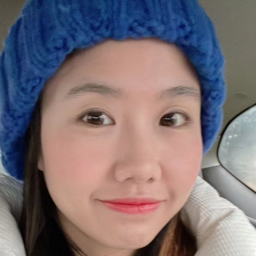

In [ ]:
# read image prompt (face, here we use a ai-generation face)
image = Image.open("/content/xwjAlign.jpg")
image.resize((256, 256))

In [ ]:
!ls /content/models

image_encoder  ip-adapter-plus-face_sd15.bin


In [ ]:
# load ip-adapter
ip_model = IPAdapterPlus(pipe, image_encoder_path, ip_ckpt, device, num_tokens=16)

  0%|          | 0/50 [00:00<?, ?it/s]

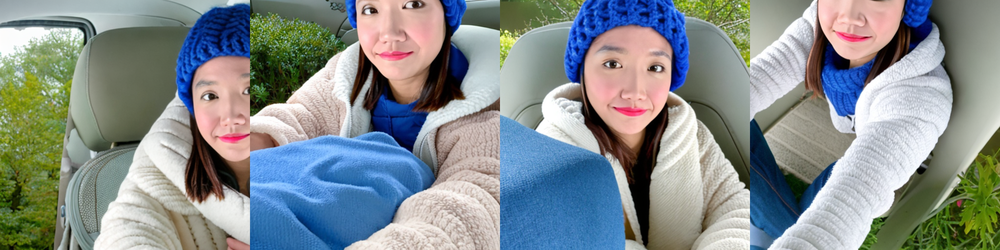

In [ ]:
images = ip_model.generate(pil_image=image, num_samples=4, num_inference_steps=50, seed=420,
        prompt="photo of a beautiful girl wearing casual shirt in a garden")
grid = image_grid(images, 1, 4)
grid

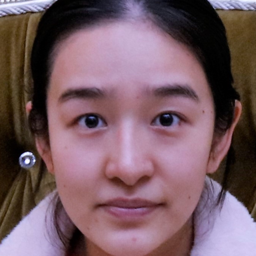

In [ ]:
# read image prompt (face, here we use a ai-generation face)
image = Image.open("/content/laopoAlign.jpg")
image.resize((256, 256))

  0%|          | 0/50 [00:00<?, ?it/s]

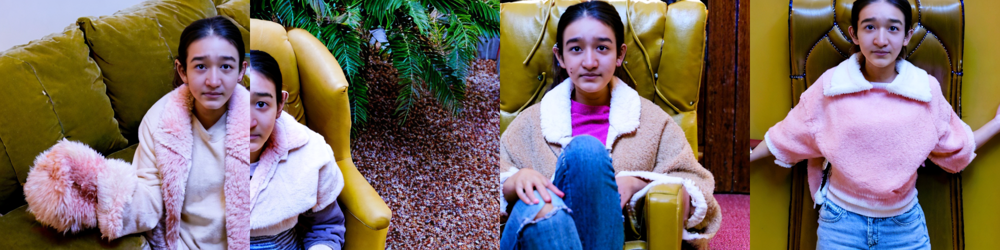

In [ ]:
images = ip_model.generate(pil_image=image, num_samples=4, num_inference_steps=50, seed=420,
        prompt="photo of a beautiful girl wearing casual shirt in a garden")
grid = image_grid(images, 1, 4)
grid

In [ ]:
del ip_model
del pipe
torch.cuda.empty_cache()

In [ ]:
# Change to a anime model
# del pipe, ip_model
torch.cuda.empty_cache()
base_model_path = "dreamlike-art/dreamlike-anime-1.0"
pipe = StableDiffusionPipeline.from_pretrained(
    base_model_path,
    torch_dtype=torch.float16,
    scheduler=noise_scheduler,
    vae=vae,
    feature_extractor=None,
    safety_checker=None
)

model_index.json:   0%|          | 0.00/511 [00:00<?, ?B/s]

Fetching 9 files:   0%|          | 0/9 [00:00<?, ?it/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/901 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/807 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

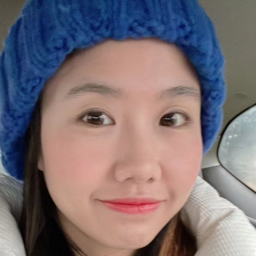

In [ ]:
# read image prompt (face, here we use a ai-generation face)
image = Image.open("/content/xwjAlign.jpg")
image.resize((256, 256))

In [ ]:
# load ip-adapter
ip_model = IPAdapterPlus(pipe, image_encoder_path, ip_ckpt, device, num_tokens=16)

  0%|          | 0/50 [00:00<?, ?it/s]

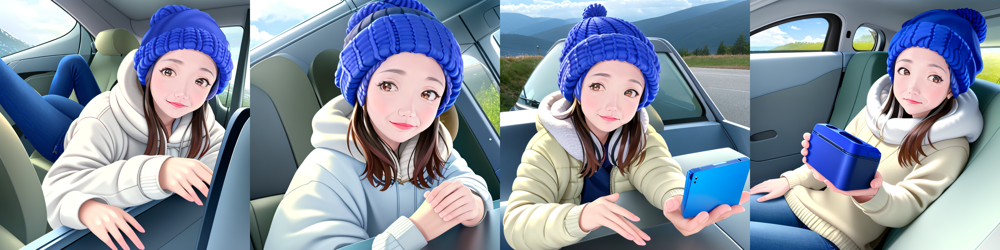

In [ ]:
images = ip_model.generate(pil_image=image, num_samples=4, num_inference_steps=50, seed=420,
        prompt="photo of a beautiful girl wearing casual shirt")
grid = image_grid(images, 1, 4)
grid

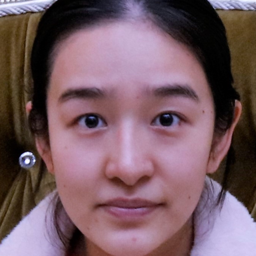

In [ ]:
# read image prompt (face, here we use a ai-generation face)
image = Image.open("/content/laopoAlign.jpg")
image.resize((256, 256))

  0%|          | 0/50 [00:00<?, ?it/s]

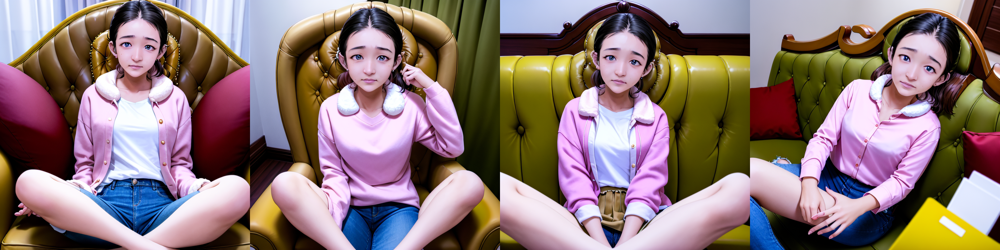

In [ ]:
images = ip_model.generate(pil_image=image, num_samples=4, num_inference_steps=50, seed=420,
        prompt="photo of a beautiful girl wearing casual shirt")
grid = image_grid(images, 1, 4)
grid

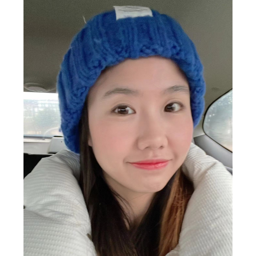

In [ ]:
# read image prompt (face, here we use a ai-generation face)
image = Image.open("/content/xwjSquare2.jpg")
image.resize((256, 256))

  0%|          | 0/50 [00:00<?, ?it/s]

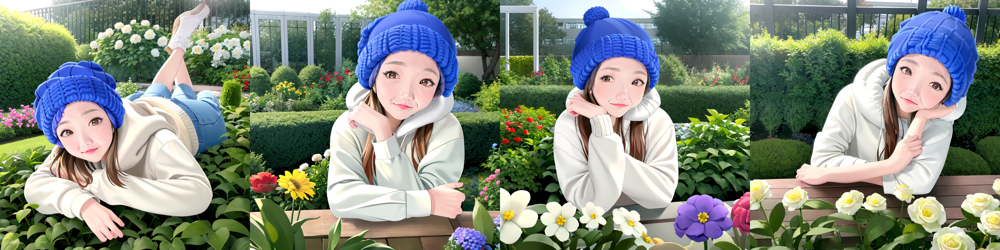

In [ ]:
images = ip_model.generate(pil_image=image, num_samples=4, num_inference_steps=50, seed=420,
        prompt="photo of a beautiful girl wearing casual shirt in a garden")
grid = image_grid(images, 1, 4)
grid

In [ ]:
from huggingface_hub import notebook_login
notebook_login()

In [ ]:
del ip_model
del pipe
torch.cuda.empty_cache()

In [ ]:
torch.cuda.empty_cache()
base_model_path = "Yntec/ChilloutMix"
pipe = StableDiffusionPipeline.from_pretrained(
    base_model_path,
    torch_dtype=torch.float16,
    scheduler=noise_scheduler,
    vae=vae,
    feature_extractor=None,
    safety_checker=None
)

model_index.json:   0%|          | 0.00/544 [00:00<?, ?B/s]

Fetching 9 files:   0%|          | 0/9 [00:00<?, ?it/s]

unet/config.json:   0%|          | 0.00/1.74k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/133 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/560 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/904 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
# load ip-adapter
ip_model = IPAdapterPlus(pipe, image_encoder_path, ip_ckpt, device, num_tokens=16)

  0%|          | 0/50 [00:00<?, ?it/s]

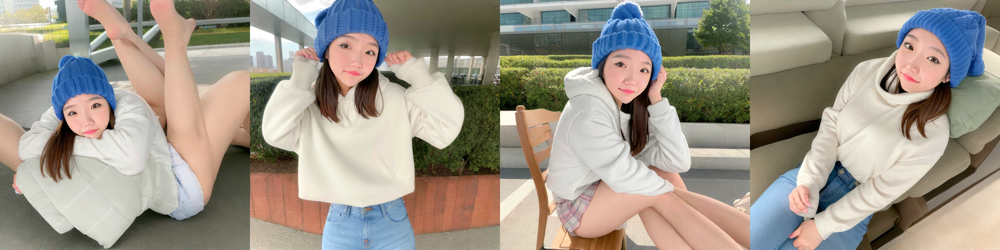

In [ ]:
images = ip_model.generate(pil_image=image, num_samples=4, num_inference_steps=50, seed=420,
        prompt="photo of a beautiful girl wearing casual shirt")
grid = image_grid(images, 1, 4)
grid

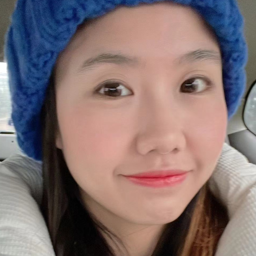

In [ ]:
# read image prompt (face, here we use a ai-generation face)
image = Image.open("/content/xwjInner.jpg")
image.resize((256, 256))

  0%|          | 0/50 [00:00<?, ?it/s]

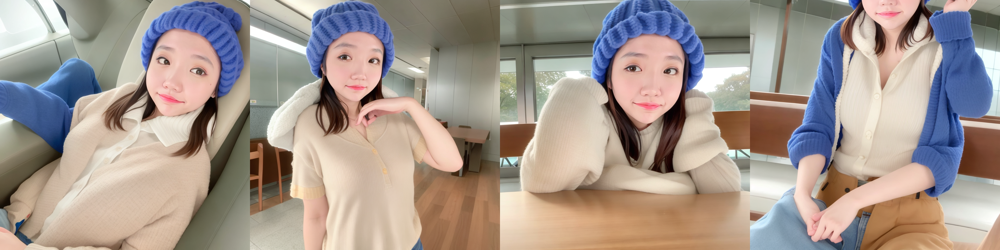

In [ ]:
images = ip_model.generate(pil_image=image, num_samples=4, num_inference_steps=50, seed=420,
        prompt="photo of a beautiful girl wearing casual shirt")
grid = image_grid(images, 1, 4)
grid

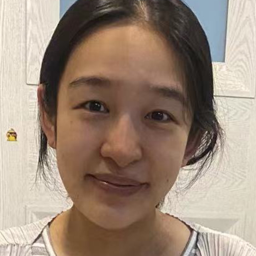

In [ ]:
# read image prompt (face, here we use a ai-generation face)
image = Image.open("/content/laopoInner.jpg")
image.resize((256, 256))

  0%|          | 0/50 [00:00<?, ?it/s]

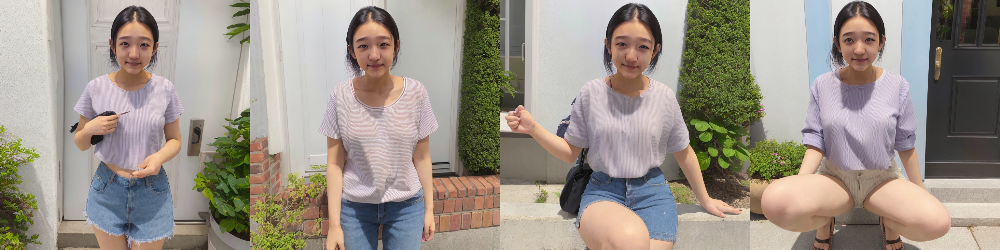

In [ ]:
images = ip_model.generate(pil_image=image, num_samples=4, num_inference_steps=50, seed=420,
        prompt="photo of a beautiful girl wearing casual shirt")
grid = image_grid(images, 1, 4)
grid